# Final Project: US flights network

**Author: José Giner**

<h2 style="color: red;"> Part 1</h2>

### Datasets description

For this project, data is acquired for both airports (nodes) and flight routes (edges).

The **airport dataset** contains geographic information of all listed airports (7698 worldwide airports) since January 2017 up until today and it is downloaded from [OpenFlights](https://openflights.org/data.html) site (airports.dat). The original information privided by each entry includes:

- Airport ID:	Unique OpenFlights identifier for this airport.
- Name:	Name of airport. May or may not contain the City name.
- City:	Main city served by airport. May be spelled differently from Name.
- Country:	Country or territory where airport is located. See Countries to cross-reference to ISO 3166-1 codes.
- IATA:	3-letter IATA code. Null if not assigned/unknown.
- ICAO:	4-letter ICAO code. Null if not assigned.
- Latitude:	Decimal degrees, usually to six significant digits. Negative is South, positive is North.
- Longitude: Decimal degrees, usually to six significant digits. Negative is West, positive is East.
- Altitude:	In feet.
- Timezone:	Hours offset from UTC. Fractional hours are expressed as decimals.
- DST:	Daylight savings time. One of E (Europe), A (US/Canada), S (South America), O (Australia), Z (New Zealand), N (None) or U (Unknown). 
- Tz database time zone:	Timezone in "tz" (Olson) format, eg. "America/Los_Angeles".
- Type:	Type of the airport. 
- Source:	Source of this data. 


The **routes dataset** contains information about more than 67663 flight routes between the defined airports on 548 different airlines. It is also provided by [OpenFlights](https://openflights.org/data.html) site (routes.dat). The original information privided by each entry includes:

- Airline:	2-letter (IATA) or 3-letter (ICAO) code of the airline.
- Airline ID:	Unique OpenFlights identifier for airline (see Airline).
- Source airport:	3-letter (IATA) or 4-letter (ICAO) code of the source airport.
- Source airport ID:	Unique OpenFlights identifier for source airport (see Airport)
- Destination airport:	3-letter (IATA) or 4-letter (ICAO) code of the destination airport.
- Destination airport ID:	Unique OpenFlights identifier for destination airport (see Airport)
- Codeshare:	"Y" if this flight is a codeshare (that is, not operated by Airline, but another carrier), empty otherwise.
- Stops:	Number of stops on this flight ("0" for direct)
- Equipment:	3-letter codes for plane type(s) generally used on this flight, separated by spaces


In my case, to make the network and task simpler, I will focus on the flight route network between airports in the United States of America.

### Data downloading and cleaning

First we import the necessary libraries that will be used:

In [1]:
import pandas as pd
import collections
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.lines as mlines

#### Read airport data:

First step is to download airport data, specifying the column names. It can be read directly from OpenFlight database Github repository. 

In [2]:
airport_col = ['ID', 'Name', 'City', 'Country','IATA', 'ICAO', 
               'Lat', 'Long', 'Alt', 'Timezone', 'DST', 'Tz database time zone', 'type', 'source']
airport_df = pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/airports.dat",
                         names = airport_col, index_col = 0)

Taking a sample of rows to see how the dataframe looks like.

In [3]:
airport_df.head()

,Name,City,Country,IATA,ICAO,Lat,Long,Alt,Timezone,DST,Tz database time zone,type,source
ID,,,,,,,,,,,,,
1,Goroka Airport,Goroka,Papua New Guinea,GKA,AYGA,-6.081690,145.391998,5282,10,U,Pacific/Port_Moresby,airport,OurAirports
2,Madang Airport,Madang,Papua New Guinea,MAG,AYMD,-5.207080,145.789001,20,10,U,Pacific/Port_Moresby,airport,OurAirports
3,Mount Hagen Kagamuga Airport,Mount Hagen,Papua New Guinea,HGU,AYMH,-5.826790,144.296005,5388,10,U,Pacific/Port_Moresby,airport,OurAirports
4,Nadzab Airport,Nadzab,Papua New Guinea,LAE,AYNZ,-6.569803,146.725977,239,10,U,Pacific/Port_Moresby,airport,OurAirports
5,Port Moresby Jacksons International Airport,Port Moresby,Papua New Guinea,POM,AYPY,-9.443380,147.220001,146,10,U,Pacific/Port_Moresby,airport,OurAirports


Count how many original rows (airports) are there.

In [4]:
len(airport_df)

7698

#### Read routes data:

Then we download flight routes data from the same source and define our columns.

In [5]:
route_cols = ['Airline', 'Airline ID', 'Source Airport', 'Source Airport ID','Dest Airport', 
              'Dest Airport ID', 'Codeshare', 'Stops', 'equipment']
routes_df = pd.read_csv("https://raw.githubusercontent.com/jpatokal/openflights/master/data/routes.dat",names = route_cols)

Taking a sample of rows to see how the dataframe looks like.

In [6]:
routes_df.head()

,Airline,Airline ID,Source Airport,Source Airport ID,Dest Airport,Dest Airport ID,Codeshare,Stops,equipment
0,2B,410,AER,2965,KZN,2990,NaN,0,CR2
1,2B,410,ASF,2966,KZN,2990,NaN,0,CR2
2,2B,410,ASF,2966,MRV,2962,NaN,0,CR2
3,2B,410,CEK,2968,KZN,2990,NaN,0,CR2
4,2B,410,CEK,2968,OVB,4078,NaN,0,CR2


Printing the number of routes:

In [7]:
len(routes_df)

67663

Printing the number of unique airlines:

In [8]:
len(routes_df['Airline ID'].unique())

548

#### Processing airports and routes datasets

The goal of this task is to obtain 2 dataframes with the following characteristics:

1) An airport dataframe in which each row represents a US airport with IATA code, total arrival and departure flights, airport name, and most importantly, longitudinal and latitudinal details for graph representation. IATA code will be our node identifier as the two datasets are connected by the code of the airport. 

2) A compact routes dataframe where each row represents a unique and national US air route defined by source and destination airport codes, and the total number of airlines operating on that route. 

First, we clean up the routes data, change 'object' type to numeric for identifiers and drops NaNs.

In [9]:
routes_df['Source Airport ID'] = pd.to_numeric(routes_df['Source Airport ID'].astype(str), 'coerce')
routes_df['Dest Airport ID'] = pd.to_numeric(routes_df['Dest Airport ID'].astype(str), 'coerce')
routes_df = routes_df.dropna(subset=["Source Airport ID", "Dest Airport ID"]) 

Fixing a particular data entry for an airport code in the airport dataframe.

In [10]:
id_dest = routes_df[routes_df['Dest Airport'] == 'HKB']['Dest Airport ID']
airport_df.at[int(id_dest),'IATA'] = 'HKB'

Extracting airports from the US and desired columns.

In [11]:
airport_us = airport_df[(airport_df.Country == "United States")][['Name','Lat', 'Long', 'IATA', 'ICAO']]
airport_us.head()

,Name,Lat,Long,IATA,ICAO
ID,,,,,
3411,Barter Island LRRS Airport,70.134003,-143.582001,BTI,PABA
3412,Wainwright Air Station,70.613403,-159.860001,\N,PAWT
3413,Cape Lisburne LRRS Airport,68.875099,-166.110001,LUR,PALU
3414,Point Lay LRRS Airport,69.732903,-163.005005,PIZ,PPIZ
3415,Hilo International Airport,19.721399,-155.048004,ITO,PHTO


Extracting routes from and to USA (national routes).

In [12]:
us_airport_ix = airport_us.index.values
routes_us = routes_df[(routes_df['Source Airport ID'].isin(us_airport_ix)) &
(routes_df['Dest Airport ID'].isin(us_airport_ix))] 

To find number of routes between 2 specific airports, we have to find number of rows in which each airport occur in the 2 columns, i.e group by source and destination airport and get the row counts. 

In [13]:
routes_us =  pd.DataFrame(routes_us.groupby(['Source Airport', 'Dest Airport']).size().reset_index(name='counts'))
routes_us.head()

,Source Airport,Dest Airport,counts
0,ABE,ATL,3
1,ABE,CLT,2
2,ABE,DTW,1
3,ABE,MYR,1
4,ABE,ORD,1


Get the total number of flights from and to each airport as a new column the airport dataframe.

In [14]:
counts = routes_us['Source Airport'].append(routes_us.loc[routes_us['Source Airport'] != routes_us['Dest Airport'], 'Dest Airport']).value_counts()
# create a data frame of position based on names in count
counts = pd.DataFrame({'IATA': counts.index, 'total_flights': counts})
pos_data = counts.merge(airport_us, on = 'IATA')
pos_data.head()


,IATA,total_flights,Name,Lat,Long,ICAO
0,ATL,305,Hartsfield Jackson Atlanta International Airport,33.636700,-84.428101,KATL
1,ORD,295,Chicago O'Hare International Airport,41.978600,-87.904800,KORD
2,DEN,295,Denver International Airport,39.861698,-104.672997,KDEN
3,DFW,274,Dallas Fort Worth International Airport,32.896801,-97.038002,KDFW
4,MSP,232,Minneapolis-St Paul International/Wold-Chamber...,44.882000,-93.221802,KMSP


Now we have our two dataframes as expected, so we are ready to perform the network analysis.

### Network analysis

First we create the graph from the routes (edge) dataset, containing the airport (node) identifiers. Since in the majority of the cases, if a flighing route exists from an airport A to an airport B, there is going to be another route from airport B to airport A, expecting in and out-degree distributions to be practically the same. This is why for this project, direction on the route is ignored and so the network will be undirected to consider the conections between airports.

In [15]:
G = nx.from_pandas_edgelist(routes_us, source = 'Source Airport', target = 'Dest Airport',
       edge_attr = 'counts')


And plot the network for an initial visualization.

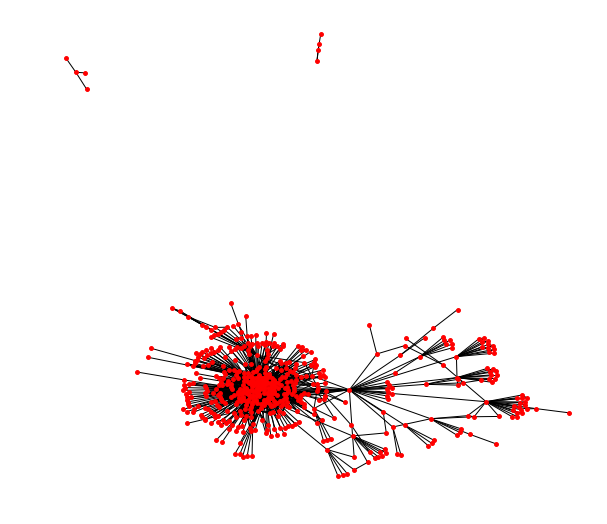

In [169]:
plt.figure(figsize = (10,9))
plt.axis('off')
pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, node_size = 15, with_labels = False)
#nx.draw_networkx_labels(G, pos, font_size = 6)

plt.show()

At first, we can see 3 components, and the largest component containing the majority of nodes in the network. We can also apreciate that some nodes are more central than others in terms of degree, that can represent well known USA airports with lots of flights to different airports. This network is similar to a scale-free one.

An interactive map visualizaton is also provided using the folium library. In this case, node size represents the total flights to and from that airport, and edge transparency represents the total number of airlines operating on a route. Also, the name of the airport is popped up if selected on a node, and operating airlines on a route, if selected an edge. 

In [18]:
import folium
import os

folium_map = folium.Map()


#Adding polylines - routes (edges)
shapes = {}
pairs = []
fl = []
for i,row in routes_us.iterrows():
    source = row['Source Airport']
    dest = row['Dest Airport']
    nflights = row['counts']
    key = tuple(sorted([source,dest]))
    if key in shapes.keys():    
        pass
        
    else:
        u = pos_data[pos_data['IATA'] == source]
        u_coords = [float(u['Lat']),float(u['Long'])]

        v = pos_data[pos_data['IATA'] == dest]
        v_coords = [float(v['Lat']),float(v['Long'])]


        shapes[key] = [nflights, u_coords, v_coords,u['IATA'].item(),v['IATA'].item()]
        fl.append(shapes[key][0])
   

max_flights = max(fl)
routes_layer = folium.FeatureGroup(name='route')
for shape_id, shape_items in shapes.items():
    nfly,u_coord,v_coord,u_iata,v_iata = shape_items
    geom = u_coord,v_coord
    polyline = folium.PolyLine(geom, popup = '{}-{}:\n {}'.format(u_iata,v_iata,str(nfly)),
                               weight=1, fill=True, opacity = round(nfly/max_flights,1), color = 'orange')
    
    routes_layer.add_child(polyline)

folium_map.add_child(routes_layer)


#Adding points - airports (nodes)
airports = {}
for i,row in pos_data.iterrows():
    airport_id = i
    name = row['Name']
    lat = row['Lat']
    long = row['Long']
    flights = row['total_flights']
    
    airports[i] = [name,flights,float(lat),float(long)]

airport_layer = folium.FeatureGroup(name = 'airports')

for airport_id, ap_geometry in airports.items():
    
    #create a point object with the coordinates of each bus stop
    name,flights,lat,long = ap_geometry
    point = folium.CircleMarker(location=[lat,long], radius=flights/50, popup = name, 
                                color = 'red', fill=True, fill_opacity=1)
    
    airport_layer.add_child(point)
    

folium_map.add_child(airport_layer)
folium_map.fit_bounds(airport_layer.get_bounds())

folium_map

### Network characterization

Basic network analysis. Divided for the whole network and giant component.

In [20]:
n = len(G)
m = len(G.edges())

degrees = [G.degree(node) for node in G]

kmin = min(degrees)
kmax = max(degrees)

print('Main parameters for the whole network')
print('-' * 20)
print('Number of nodes: {}'.format(n))
print('Number of edges: {}'.format(m))
print("Average degree: ", round(2*m/n,3))

print("Minimum degree: ", kmin)
print("Maximum degree: ", kmax)
print("Connected components: ", nx.number_connected_components(G))


Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G0 = G.subgraph(Gcc[0])

n_giant = len(G0)
m_giant = len(G0.edges())

degr = [G0.degree(node) for node in G0]

kmin = min(degr)
kmax = max(degr)

print('\n\nMain parameters for the giant component')
print('-' * 20)
print('Number of nodes: {}'.format(n_giant))
print('Number of edges: {}'.format(m_giant))
print("Average degree: ", round(2*m_giant/n_giant,3))

print("Minimum degree: ", kmin)
print("Maximum degree: ", kmax)

Main parameters for the whole network
--------------------
Number of nodes: 549
Number of edges: 2787
Average degree:  10.153
Minimum degree:  1
Maximum degree:  153
Connected components:  3


Main parameters for the giant component
--------------------
Number of nodes: 541
Number of edges: 2780
Average degree:  10.277
Minimum degree:  1
Maximum degree:  153


Degree distribution in linear scale

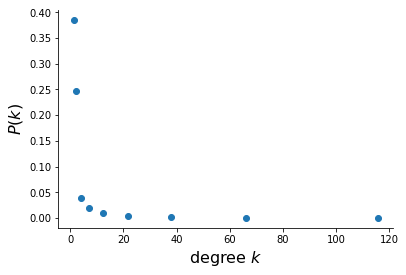

In [28]:
bin_edges = np.logspace(np.log10(kmin), np.log10(kmax), num=10)


density, _ = np.histogram(degrees, bins=bin_edges, density=True)

fig = plt.figure(figsize=(6,4))


log_be = np.log10(bin_edges)
x = 10**((log_be[1:] + log_be[:-1])/2)

plt.plot(x, density, marker='o', linestyle='None' )
plt.xlabel(r"degree $k$", fontsize=16)
plt.ylabel(r"$P(k)$", fontsize=16)


ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')


plt.show()

Degree distribution in loglog scale

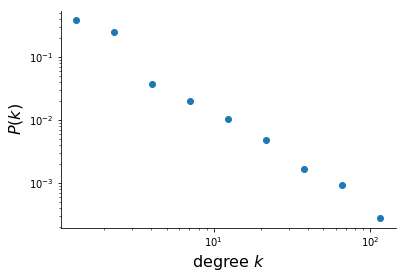

In [27]:
plt.loglog(x, density, marker='o', linestyle='None')
plt.xlabel(r"degree $k$", fontsize=16)
plt.ylabel(r"$P(k)$", fontsize=16)

# remove right and top boundaries because they're ugly
ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

# Show the plot
plt.show()

We can clearly see a power law characterized distribution for our flight routes network. We will later find who are those hubs with large degree or in this case airports with high amount of destinations to travel.

Next, we show the average path length. As the graph contains many edges, calculating the exact average path length may be a computationally expensive operation, so this is why an estimation is done based on an selecting random trials of node pairs to measure its shortest path length and then average them. Although exact value is not obtained, a good estimation is obtained.

In [96]:
def sample_path_lengths(G, nodes=None, trials=1000):
    if nodes is None:
        nodes = list(G)
    else:
        nodes = list(nodes)

    pairs = np.random.choice(nodes, (trials, 2))
    lengths = []
    
    
    for pair in pairs:
        try:
            spl = nx.shortest_path_length(G, *pair)
            lengths.append(spl)
            
        except nx.NetworkXNoPath:
            pass
        
    return lengths

In [97]:
def estimate_path_length(G, nodes=None, trials=1000):
    return np.mean(sample_path_lengths(G, nodes, trials))

In [98]:
L = estimate_path_length(G)
print("Average path length estimation:",round(L,3))

Average path length estimation: 3.189


This estimation supports the small world theorem observed in scale free networks.

Average clustering coefficient estimation is now performed.

In [99]:
from networkx.algorithms.approximation import average_clustering

C = average_clustering(G)
print("Clustering coefficient estimation:",C)

Clustering coefficient estimation: 0.497


Through this metric, we can know that in average, the neighborhood of a node is well connected. In this case, a value close to 0.5 could mean that about half of the total posible links joining neighbors of a node do actually exist. 

For the diameter calculation of the network, only the giant connected component is considered

In [100]:
d = nx.diameter(G0)
print("Diameter of the network: ",d)

Diameter of the network:  7


### Centrality measures

In this section, we will analyze which airports are the ones that operate the most in our network and so their presence is key for travel destinations and connecting with other airports. For that, several centrality measures are shown for the best 10 nodes. These include, degree centrality (normalized), betweenness centrality, closeness centrality, eigenvector centrality and PageRank centrality.

First, we will find nodes/airports with greatest degree centrality.

In [41]:
dc = dict(sorted(G.degree, key=lambda x: x[1], reverse=True))
top10_dc = {k: dc[k] for k in list(dc)[:10]}
for k,v in top10_dc.items():
    print('{} - {}'.format(k,v))

ATL - 153
ORD - 149
DEN - 149
DFW - 138
MSP - 117
DTW - 114
LAS - 113
CLT - 110
IAH - 101
PHL - 88


Normalized version

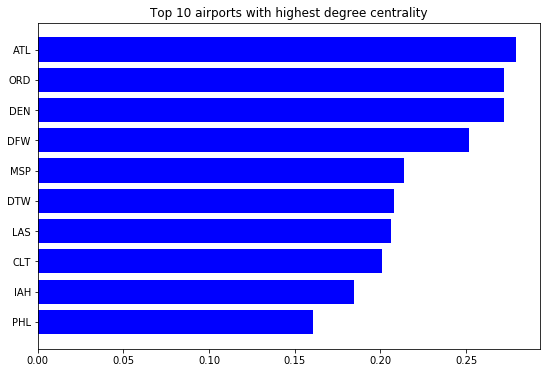

In [20]:
dc = nx.degree_centrality(G)

dc = dict(sorted(dc.items(), key=lambda item: item[1], reverse = True))
top10_dc = {k: dc[k] for k in list(dc)[:10]}

names = list(top10_dc.keys())
values = list(top10_dc.values())

y_pos = np.arange(len(names))

plt.figure(figsize = (9,6))
plt.barh(y_pos, values, color = 'b')
plt.yticks(y_pos, names)
plt.title('Top 10 airports with highest degree centrality')
plt.gca().invert_yaxis()
plt.show()

There is not a specific airport that stands out in this centrality score, but we can highlight some highly operating airports such as Atlanta International Airport (ATL), Chicago O'Hare International Airport (ORD) and Denver International Airport (DEN).

Finding nodes/airports with the highest betweenness centrality

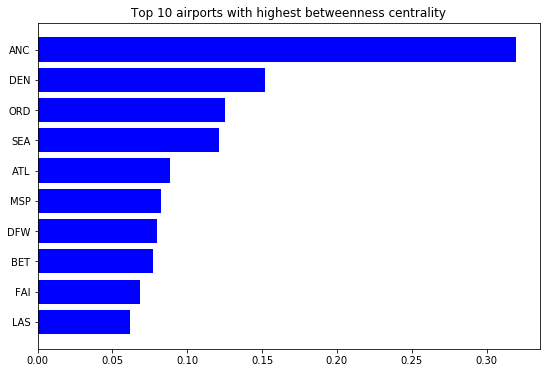

In [35]:
bc = nx.betweenness_centrality(G)
bc = dict(sorted(bc.items(), key=lambda item: item[1], reverse = True))
top10_bc = {k: bc[k] for k in list(bc)[:10]}

names = list(top10_bc.keys())
values = list(top10_bc.values())

y_pos = np.arange(len(names))

plt.figure(figsize = (9,6))
plt.barh(y_pos, values, color = 'b')
plt.yticks(y_pos, names)
plt.title('Top 10 airports with highest betweenness centrality')
plt.gca().invert_yaxis()
plt.show()

Checking the name of the airport with highest betweenness centrality score by accessing to the airports dataframe.

In [38]:
pos_data[pos_data['IATA'] == 'ANC']

,IATA,total_flights,Name,Lat,Long,ICAO
39,ANC,68,Ted Stevens Anchorage International Airport,61.1744,-149.996002,PANC


In this case for the betweenness centrality, we do see that Ted Stevens Anchorage International Airport (ANC) stands out in terms of its ability to join together different airports which do not have a direct flight route between them. Looking at the map from above, this airport is located in the state of Alaska and is the main one that connects other airports in that state with the others from the rest of states. 

Now, we find the nodes/airports with the highest closeness centrality. 

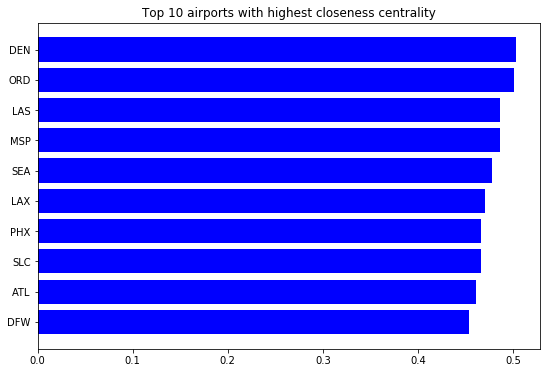

In [28]:
cc = nx.closeness_centrality(G)
cc = dict(sorted(cc.items(), key=lambda item: item[1], reverse = True))
top10_cc = {k: cc[k] for k in list(cc)[:10]}

names = list(top10_cc.keys())
values = list(top10_cc.values())

y_pos = np.arange(len(names))

plt.figure(figsize = (9,6))
plt.barh(y_pos, values, color = 'b')
plt.yticks(y_pos, names)
plt.title('Top 10 airports with highest closeness centrality')
plt.gca().invert_yaxis()
plt.show()

As happened with degree centrality, there is not a particular airport that we can mention here, but we can see many of them that are closer to other ones in terms of average path lengths.

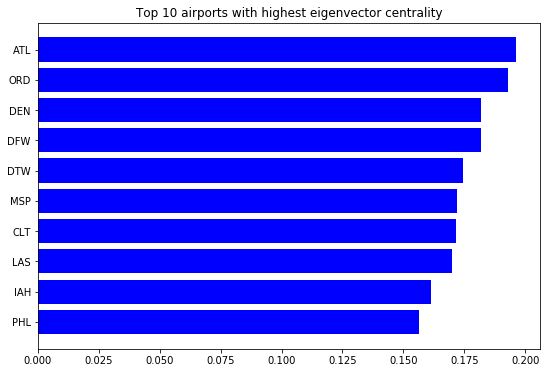

In [27]:
ec = nx.eigenvector_centrality(G)
ec = dict(sorted(ec.items(), key=lambda item: item[1], reverse = True))
top10_ec = {k: ec[k] for k in list(ec)[:10]}

names = list(top10_ec.keys())
values = list(top10_ec.values())

y_pos = np.arange(len(names))

plt.figure(figsize = (9,6))
plt.barh(y_pos, values, color = 'b')
plt.yticks(y_pos, names)
plt.title('Top 10 airports with highest eigenvector centrality')
plt.gca().invert_yaxis()
plt.show()

Using the eigenvector centrality to award nodes proportionally to the centrality scores of its neighbors, we could mention again Atlanta's International Airport (ATL) and Chicago O'Hare International Airport (ORD) because they have connections to more operational airports (important nodes). Comparing these top 10 airports with the top ones in degree centrality, we can see that these are the same airports and can suggest that they are connected between them to achieve these scores. 

Finding nodes/airports with the highest PageRank centrality

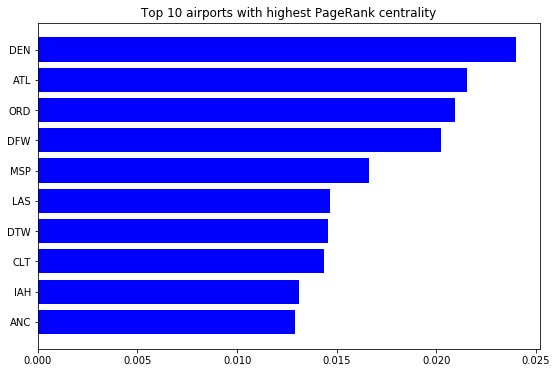

In [26]:
pageRank = nx.pagerank(G)

pageRank = dict(sorted(pageRank.items(), key=lambda item: item[1], reverse = True))
top10_pr = {k: pageRank[k] for k in list(pageRank)[:10]}

names = list(top10_pr.keys())
values = list(top10_pr.values())

y_pos = np.arange(len(names))

plt.figure(figsize = (9,6))
plt.barh(y_pos, values, color = 'b')
plt.yticks(y_pos, names)
plt.title('Top 10 airports with highest PageRank centrality')
plt.gca().invert_yaxis()
plt.show()

The PageRank is defined for directed graphs, but in this case it is used for an undirected graph and so it can present some proportionality with the degree centrality, by considering both directions in edges. However, we can see that the order changes when looking at the these scores, where now Denver International Airport (DEN) tops the list. 

### Conclusions

Through this first network analysis task, we firstly saw how the US flight route graph looked similar to a scale-free network, characterized by having some airports acting as hubs that operate or have flights to many other airports in the country. We then extracted some basic network parameters such as the number of nodes and edges, average degree or connected componets in the graph to understand more about its composition, following with a clustering coefficient to know information about neighbor connectivity and average path length estimation to confirm the small-world theorem present in power law graphs, that can be identified just by looking at the degree distribution and seeing how max degree varies from min degree. 

Then we identified the most relevant nodes or aiports that play an important role in the air traffic network, by looking at the top degree centrality scorers as well as for betweenness, closeness, eigenvector and PageRank centrality. From these scores, we can say that some of the largest airports include Hartsfield Jackson Atlanta International Airport, Chicago O’Hare International Airport or Denver International Airport, but we can see others that have an important role in connecting airports which do not have direct flights between them such as Ed Stevens Anchorage International Airport located in Alaska, that obtained the best betweenness centrality by far.

<h2 style="color: red;"> Part 2</h2>

### Comparison with a random network

To start off with this second part, a fair comparison of our flights network with a random network is done to observe the main differences in both degree distributions and network parameters. By fair, I mean generating a random graph with the same number of nodes (n) and probability of joining to nodes with an edge (p) equivalent to the average degree (extracted from before) over n. Position of nodes are consistent with the real airport locations. I would have liked to plot the nodes in a map using the [Basemap](https://matplotlib.org/basemap/) library but I had problems with the installation so finally nodes are plotted in standard background.

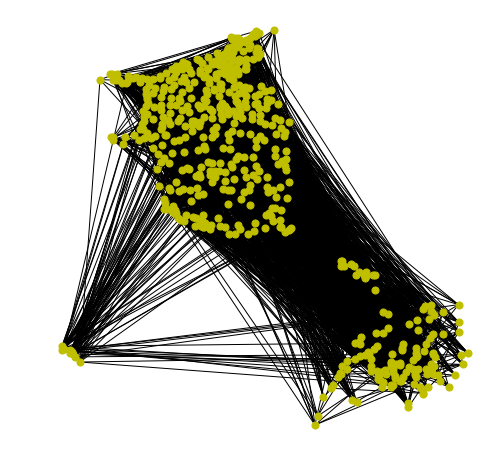

In [59]:
plt.figure(figsize = (8,8))


p = ((2*m)/n)/n #avg degree over total nodes
G_random = nx.erdos_renyi_graph(n, p)

airports_coords = {}
for i,row in pos_data.iterrows():
    airport_id = i
    lat = row['Lat']
    long = row['Long']
    
    airports_coords[i] = [float(lat),float(long)]

plt.axis('off')
nx.draw_networkx(G_random, pos = airports_coords, node_size = 50, with_labels = False, node_color = 'y')

plt.show()

Lets now see basic network parameters and compare them with our real network.

In [61]:
n_rand = len(G_random)
m_rand = len(G_random.edges())

degrees_rand = [G_random.degree(node) for node in G_random]

kmin_rand = min(degrees_rand)
kmax_rand = max(degrees_rand)

print('Main parameters for the random network generated')
print('-' * 60)
print('Number of nodes: {}'.format(n_rand))
print('Number of edges: {}'.format(m_rand))
print("Average degree: ", round(2*m_rand/n_rand,3))

print("Minimum degree: ", kmin_rand)
print("Maximum degree: ", kmax_rand)
print("Connected components: ", nx.number_connected_components(G_random))

Main parameters for the random network generated
------------------------------------------------------------
Number of nodes: 549
Number of edges: 2786
Average degree:  10.149
Minimum degree:  4
Maximum degree:  21
Connected components:  1


There is only one connected component and  average degree is greater than log(n), meaning that the graph falls in the connected region. Also, maximum degree is not that high for the random network (highest degree was 153 in the real network). Similar average degree is seen but random network has a defined range of degree values. Now lets study its degree distribution. 

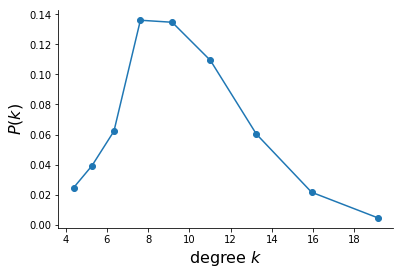

In [66]:
bin_edges = np.logspace(np.log10(kmin_rand), np.log10(kmax_rand), num=10)


density, _ = np.histogram(degrees_rand, bins=bin_edges, density=True)

fig = plt.figure(figsize=(6,4))


log_be = np.log10(bin_edges)
x = 10**((log_be[1:] + log_be[:-1])/2)

plt.plot(x, density, marker='o')
plt.xlabel(r"degree $k$", fontsize=16)
plt.ylabel(r"$P(k)$", fontsize=16)


ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')


plt.show()

We can see a gaussian distribution with a peak near the average degree, and unlike our scale-free network, degrees are contained in a closed and defined interval, where the difference between minmum and maximum degree is not as large, without the presence of hubs.

In [71]:
C = average_clustering(G_random)
print("Clustering coefficient estimation:",C)


Clustering coefficient estimation: 0.019


Clustering coefficient is lower meaning that neighbors are not quite connected, in fact it is close to 0. This value is far apart from the real cc which was about 0.5.

In [76]:
L = estimate_path_length(G_random)
print("Average path length estimation:",round(L,3))

Average path length estimation: 2.951


We also observe a low average path length estimation but it is a good estimate to the actual value.

In general, we can say that the ER-model for random networks is a bad estimator for degree distribution as many nodes have larger degree than predicted, and is also a bad model for clustering coefficient estimation as neighbors are more connected. However, its average path length estimate is quite close to the real one, so in that aspect it, is a good model.

### Community analysis

Our aim in this section is to check the existance of node groups (airports in this case) that form densely connected components in the network and therefore detect possible node communities. The community detection algorithms to be tested are Girvan-Newman and Lovain algorithms. Girvan-Newman is a divisive method which detects communities by progressively removing edges from the original network, paying more attention on edges that most likely connect communities. Lovain method maximizes a modularity score for each community. The modularity quantifies the quality of an assignment of nodes to communities, so it is a metric that the algorithm must optimize to obtain the best partition of nodes.

Now we implement Girvan Newman and Louvain algorithms for generating communities of airports.

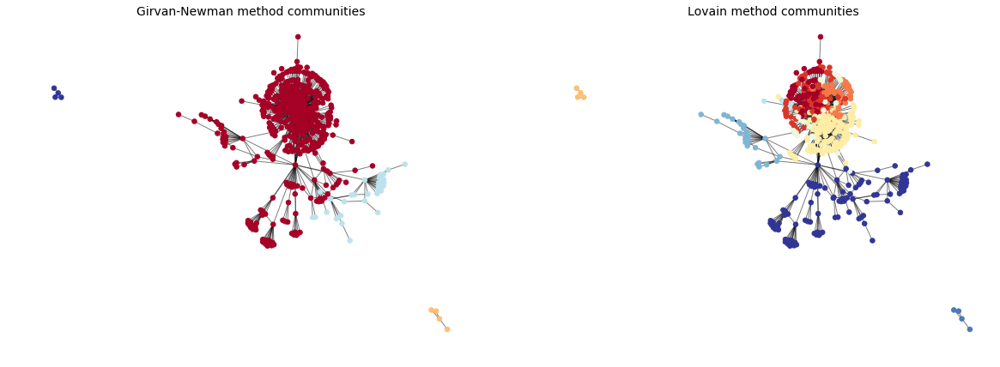

In [215]:
from community import community_louvain
from networkx.algorithms.community.centrality import girvan_newman
from collections import defaultdict

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 7))
pos = nx.spring_layout(G)

comp = girvan_newman(G)
membership = tuple(c for c in next(comp))

partition = defaultdict(list)
c = 0
for p in membership:
    for node in p:
        partition[c].append(node)
    c += 1

gn_partition = [k for n in G.nodes() for k,v in partition.items() if n in v]

ax1.set_axis_off()
ax1.set_title('Girvan-Newman method communities', fontsize=14)
nx.draw_networkx_nodes(G, pos, cmap=plt.cm.RdYlBu, node_color=gn_partition, node_size = 30, ax = ax1)
nx.draw_networkx_edges(G, pos, alpha=0.5, ax = ax1)
#nx.draw_networkx_labels(G, pos, ax = ax1, font_size = 6)



louvain_partition = community_louvain.best_partition(G)

ax2.set_axis_off()
ax2.set_title('Lovain method communities', fontsize=14)
nx.draw_networkx_nodes(G, pos, cmap=plt.cm.RdYlBu, node_color=list(louvain_partition.values()), node_size = 30, ax = ax2)
nx.draw_networkx_edges(G, pos, alpha=0.5, ax=ax2)
#nx.draw_networkx_labels(G, pos, ax=ax2, font_size = 6)

plt.show()

Now we visualize Girvan Newman communities in an interactive map built with Folium, to know where communities are located.

In [231]:
import random
folium_map = folium.Map(tiles = 'CartoDB positron')


#Adding polylines - routes (edges)
shapes = {}
pairs = []
fl = []
for i,row in routes_us.iterrows():
    source = row['Source Airport']
    dest = row['Dest Airport']
    nflights = row['counts']
    key = tuple(sorted([source,dest]))
    if key in shapes.keys():    
        pass
        
    else:
        u = pos_data[pos_data['IATA'] == source]
        u_coords = [float(u['Lat']),float(u['Long'])]

        v = pos_data[pos_data['IATA'] == dest]
        v_coords = [float(v['Lat']),float(v['Long'])]


        shapes[key] = [nflights, u_coords, v_coords,u['IATA'].item(),v['IATA'].item()]
        fl.append(shapes[key][0])
   

max_flights = max(fl)
routes_layer = folium.FeatureGroup(name='route')
for shape_id, shape_items in shapes.items():
    nfly,u_coord,v_coord,u_iata,v_iata = shape_items
    geom = u_coord,v_coord
    polyline = folium.PolyLine(geom, popup = '{}-{}:\n {}'.format(u_iata,v_iata,str(nfly)),
                               weight=1, fill=True, opacity = round(nfly/max_flights,1), color = 'orange')
    
    routes_layer.add_child(polyline)

folium_map.add_child(routes_layer)


#Adding points - airports (nodes)
airports = {}
communities = {}
for i,row in pos_data.iterrows():
    airport_id = i
    iata = row['IATA']
    name = row['Name']
    lat = row['Lat']
    long = row['Long']
    flights = row['total_flights']
    
    airports[i] = [name,iata,flights,float(lat),float(long)]
    for p,v in partition.items():
        if iata in v:
            communities[iata] = p 

airport_layer = folium.FeatureGroup(name = 'airports')

colors = {}

for airport_id, ap_geometry in airports.items():
    
    #create a point object with the coordinates of each bus stop
    name,iata,flights,lat,long = ap_geometry
    com = communities[iata]
    if com not in colors.keys():
        color = "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             
        colors[com] = color
    
    
    point = folium.CircleMarker(location=[lat,long], radius=flights/50, popup = name, 
                                color = colors[com], fill=True, fill_opacity=1)
    
    airport_layer.add_child(point)
    

folium_map.add_child(airport_layer)
folium_map.fit_bounds(airport_layer.get_bounds())





folium_map

Looking at the 4 communities generated by Girvan Newman method, we can se a huge community were the majority of airports are assigned to. The other three comunities are smaller, one containing a reasonable amount of airports from Alaska state, and other one from Alaska's southern islands.

Getting the modularity of the partition generated by the Louvain method.

In [102]:
import community
modularity = community.modularity(louvain_partition, G)
print("The modularity Q is {}".format(round(modularity,3)))

The modularity Q is 0.351


As Q > 0, there could be a potential partition.

Now we visualize Louvain communities in the interactive map to see where communities are located.

In [223]:
folium_map = folium.Map(tiles = 'CartoDB positron')


#Adding polylines - routes (edges)
shapes = {}
pairs = []
fl = []
for i,row in routes_us.iterrows():
    source = row['Source Airport']
    dest = row['Dest Airport']
    nflights = row['counts']
    key = tuple(sorted([source,dest]))
    if key in shapes.keys():    
        pass
        
    else:
        u = pos_data[pos_data['IATA'] == source]
        u_coords = [float(u['Lat']),float(u['Long'])]

        v = pos_data[pos_data['IATA'] == dest]
        v_coords = [float(v['Lat']),float(v['Long'])]


        shapes[key] = [nflights, u_coords, v_coords,u['IATA'].item(),v['IATA'].item()]
        fl.append(shapes[key][0])
   

max_flights = max(fl)
routes_layer = folium.FeatureGroup(name='route')
for shape_id, shape_items in shapes.items():
    nfly,u_coord,v_coord,u_iata,v_iata = shape_items
    geom = u_coord,v_coord
    polyline = folium.PolyLine(geom, popup = '{}-{}:\n {}'.format(u_iata,v_iata,str(nfly)),
                               weight=1, fill=True, opacity = round(nfly/max_flights,1), color = 'orange')
    
    routes_layer.add_child(polyline)

folium_map.add_child(routes_layer)


#Adding points - airports (nodes)
airports = {}
communities = {}
for i,row in pos_data.iterrows():
    airport_id = i
    iata = row['IATA']
    name = row['Name']
    lat = row['Lat']
    long = row['Long']
    flights = row['total_flights']
    
    airports[i] = [name,iata,flights,float(lat),float(long)]

airport_layer = folium.FeatureGroup(name = 'airports')

colors = {}

for airport_id, ap_geometry in airports.items():
    
    #create a point object with the coordinates of each bus stop
    name,iata,flights,lat,long = ap_geometry
    com = louvain_partition[iata]
    if com not in colors.keys():
        color = "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             
        colors[com] = color
    
    
    point = folium.CircleMarker(location=[lat,long], radius=flights/50, popup = name, 
                                color = colors[com], fill=True, fill_opacity=1)
    
    airport_layer.add_child(point)
    

folium_map.add_child(airport_layer)
folium_map.fit_bounds(airport_layer.get_bounds())





folium_map

These partitions seem more interesting. We can see a community of western airports + airports from Hawai, a community of south east airports, where we can find Dallas Fort Worth International Airport, a community containing airports with large number of flights, like Atlanta Internatinnal Airport, Detroit County Airport and Chicago O'Hare International Airport. Other geographical based communities can be also apreciated like ones containing airports from Alaska, and other containing east coast airports.

### Network robustness analysis
Robustness of transportation networks is one of the major challenges of the 21st century. Attacking strategies to an airport can severely affect the air traffic system and coordination with other airports, specially in a scale free network, were interoperation with central nodes or hubs is essential. In this section we will test in several ways the robustness of the US air traffic network, by measuring network efficiency under a random and deliverate attacks, and simulating cascade failures. 

Starting with a random permutation of airports to be sequentialy disclosed

In [32]:
from tqdm import tqdm
eff1 = []
Geff = G.copy()

# random order for deletion
remove = np.random.permutation(G.nodes())
for i in tqdm(range(len(G))):
    
    Geff.remove_nodes_from(remove[:i])
    eff1.append(nx.global_efficiency(Geff))

    Geff = G.copy()
    

100%|██████████████████████████████████████████████████████████████████████████████| 549/549 [1:29:53<00:00,  9.82s/it]


Now the removal order is determined by the degree of the nodes.

In [34]:
eff2 = []
Geff = G.copy()

# degree descending order for deletion
nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)
remove = []
for n,d in nodes:
    remove.append(n)
    
for i in tqdm(range(len(G))):
    
    Geff.remove_nodes_from(remove[:i])
    eff2.append(nx.global_efficiency(Geff))

    Geff = G.copy()

100%|████████████████████████████████████████████████████████████████████████████████| 549/549 [18:08<00:00,  1.98s/it]


Plotting efficiency evolution for both random and deliberate attacks

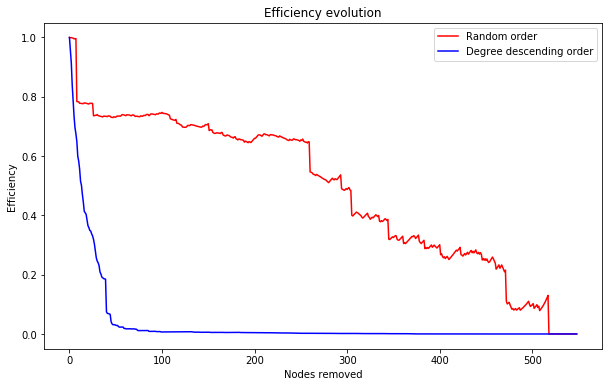

In [50]:
plt.figure(figsize = (10,6))
plt.plot(np.array(eff1) / eff1[0], c = 'r', label = 'Random order')
plt.plot(np.array(eff2) / eff2[0], c = 'b', label = 'Degree descending order')
plt.xlabel('Nodes removed') 
plt.ylabel('Efficiency')
plt.title('Efficiency evolution')
plt.legend(loc='best')
plt.show()

As scale free networks are vulnerable to deliberate attacks, if we remove high degree nodes first, the network efficiency drops significantly because the average path length of the network increases. However during a random attack, the network resists more as random nodes are selected in each step so efficiency drops in a moderate way. 

### Cascade failures

For cascade failures we focus only on the giant component because it is a node dependent failure. First we simulate a cascade failure under a random attack. 

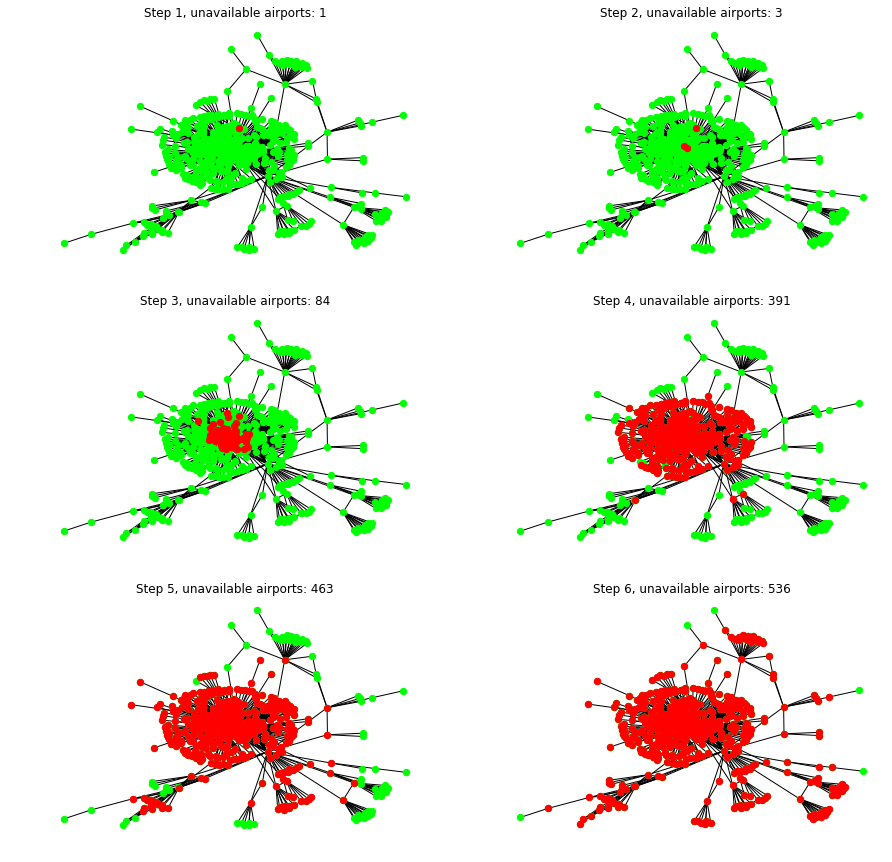

In [76]:
import random

#Simulate the cascade failure over giant component
steps = range(1,7)
fig, axes = plt.subplots(len(steps)//2 , 2, figsize = (15,15))
list_axes = [axes[0][0],axes[0][1],axes[1][0],axes[1][1], axes[2][0], axes[2][1]]
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G0 = G.subgraph(Gcc[0])

# start with one random closed airport
damaged,total_infected_random = [] , []

start_node = random.choice(list(G0.nodes()))
damaged.append(start_node)

count_axes = 0

for s in steps:

    nx.draw(G0,pos=pos, node_color = 'lime', node_size = 40, ax = list_axes[count_axes])
    nx.draw_networkx_nodes(G0.subgraph(damaged),pos=pos,node_color='red', node_size = 40, ax = list_axes[count_axes])
    list_axes[count_axes].set_title('Step {}, unavailable airports: {}'. format(str(s),str(len(damaged))))
    count_axes += 1
    total_infected_random.append(len(damaged))
    
    frontier = nx.node_boundary(G0,damaged)
    for node in frontier:
        damaged.append(node)
     
    
plt.show()




We can see how quickly the failure expands in short steps through all the network.

Lets check the effect when simulating a cascade failure under a deliberate attack, i.e selecting the node or airport with most degree or operating routes first.

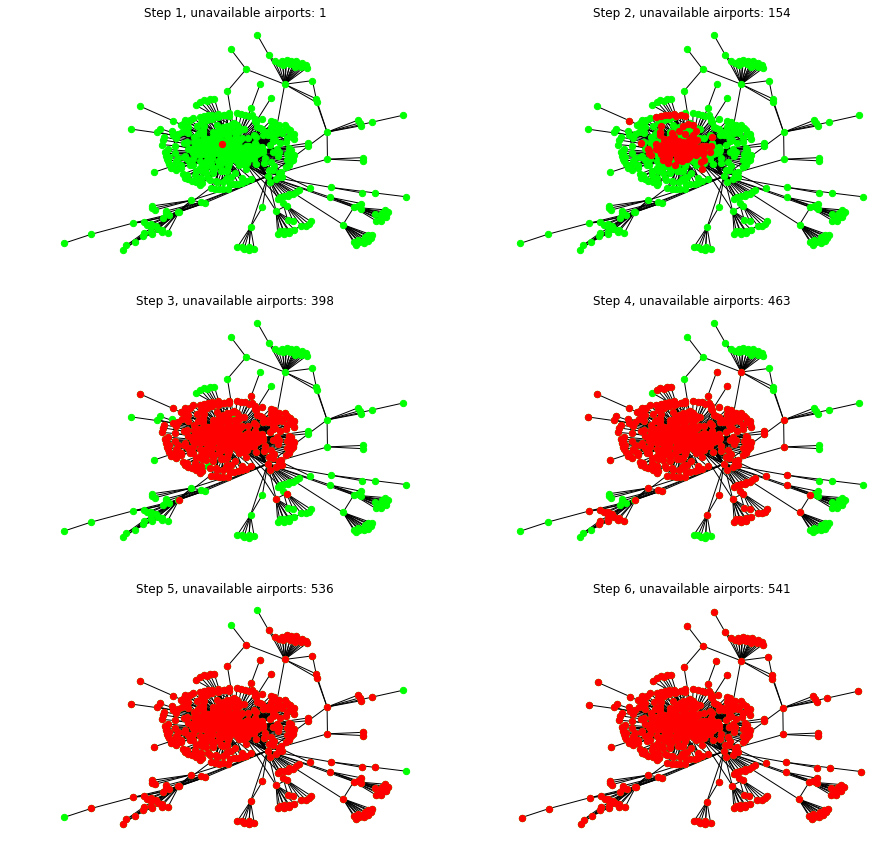

In [77]:
fig, axes = plt.subplots(len(steps)//2 , 2, figsize = (15,15))
list_axes = [axes[0][0],axes[0][1],axes[1][0],axes[1][1], axes[2][0], axes[2][1]]

damaged,total_infected_highest_degree = [] , []

nodes = sorted(G0.degree, key=lambda x: x[1], reverse=True)
start_node = nodes[0][0]
damaged.append(start_node)
count_ax = 0

for s in steps:
    
    nx.draw(G0,pos=pos, node_color = 'lime', node_size = 40, ax = list_axes[count_ax])
    nx.draw_networkx_nodes(G0.subgraph(damaged),pos=pos,node_color='red', node_size = 40, ax = list_axes[count_ax])
    list_axes[count_ax].set_title('Step {}, unavailable airports: {}'. format(str(s),str(len(damaged))))
    count_ax += 1
    total_infected_highest_degree.append(len(damaged))
    
    frontier = nx.node_boundary(G0,damaged)
    for node in frontier:
        damaged.append(node)
     

plt.show()

Now we plot the cascade failure evolutions (random inital node vs highest degree node)

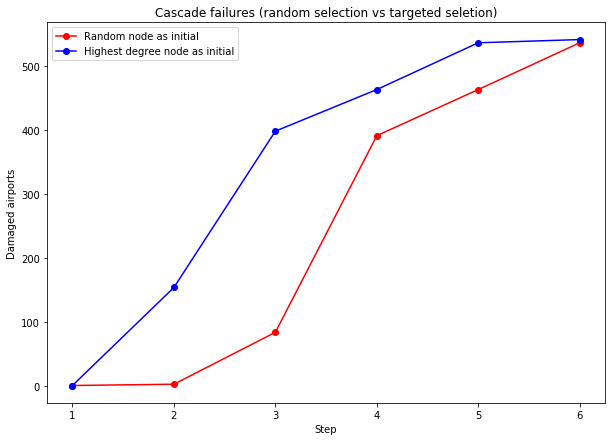

In [78]:
plt.figure(figsize=(10,7))
plt.plot(steps,total_infected_random, 'o-', c = 'r', label = 'Random node as initial')
plt.plot(steps,total_infected_highest_degree, 'o-', c = 'b' , label = 'Highest degree node as initial')
plt.xlabel('Step')
plt.ylabel('Damaged airports')
plt.title('Cascade failures (random selection vs targeted seletion)')
plt.legend()

plt.show()

As expected, more airports are out of service in earlier steps when the highest operating airport fails first. With this we see the impact a targeted failure selection has on a scale free network like the one we have.

### Diffusion in network

Lets say that a virus in an airport's operating system is detected and that this virus can propagate to other airports that have requested information or been communicating with this airport. Lets say this only applies to connected airports by a direct flight between them, and if an airport's software gets infected, the virus can't be removed. For this situation, we are going to simulate a SI model to see the evolution of the number of susceptible airports and infected ones by this malware that spreads through informatic systems. Again, we only consider the giant conected component.

We test two SI modes one with beta = 0.25 and beta = 0.5

Day 1
Infected nodes: 1


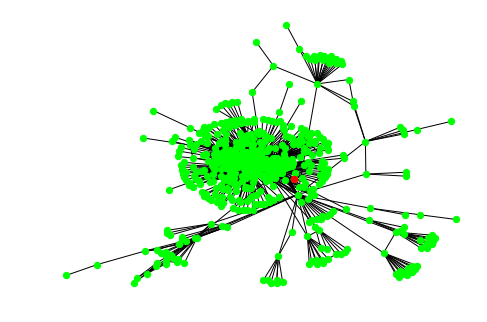

Day 2
Infected nodes: 1


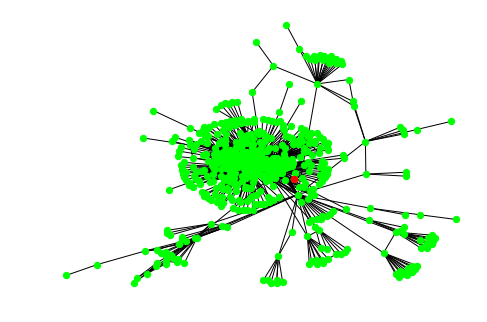

Day 3
Infected nodes: 2


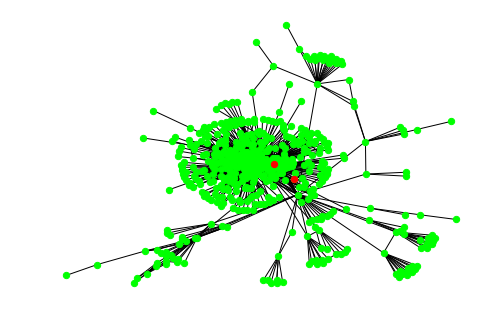

Day 4
Infected nodes: 20


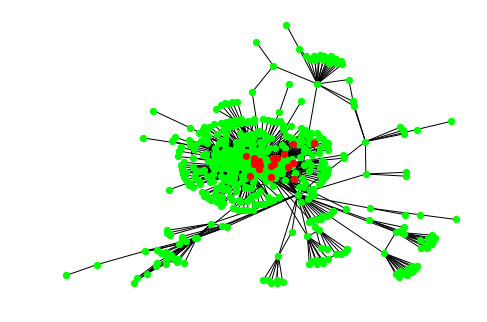

Day 5
Infected nodes: 70


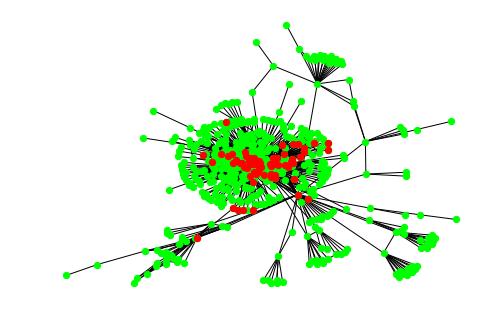

Day 6
Infected nodes: 136


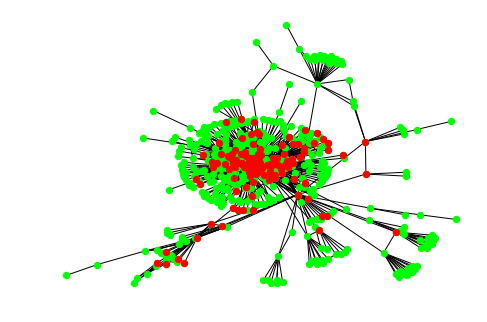

Day 7
Infected nodes: 200


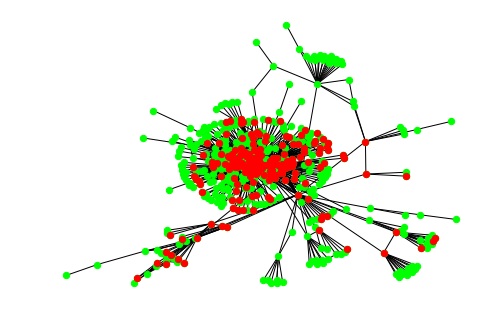

Day 8
Infected nodes: 262


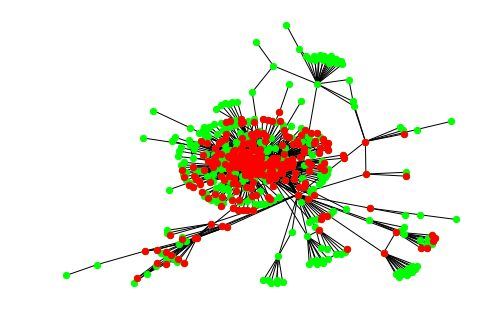

Day 9
Infected nodes: 311


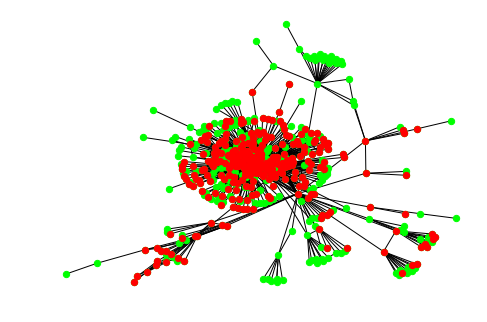

Day 10
Infected nodes: 348


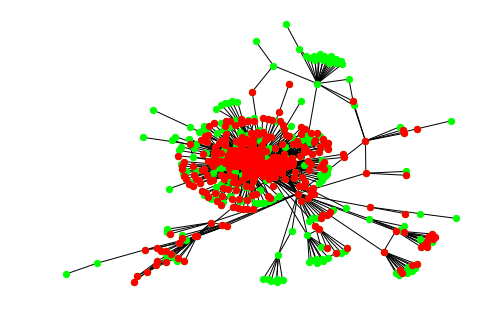

Day 11
Infected nodes: 380


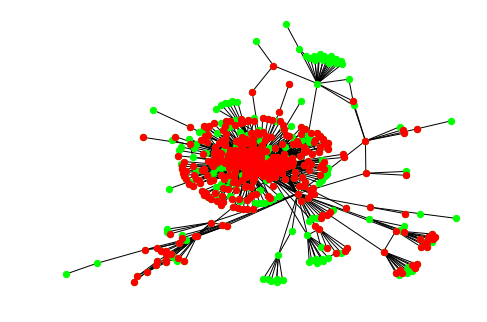

Day 12
Infected nodes: 406


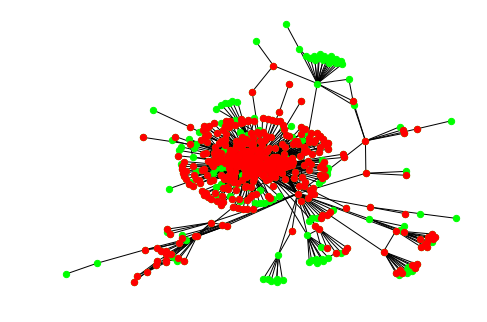

Day 13
Infected nodes: 437


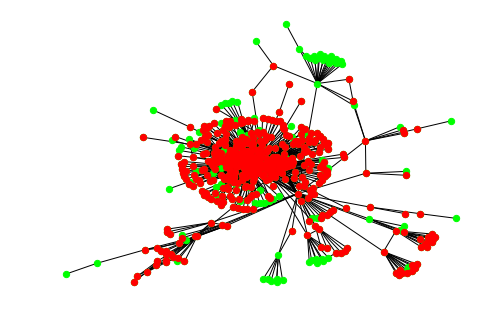

Day 14
Infected nodes: 453


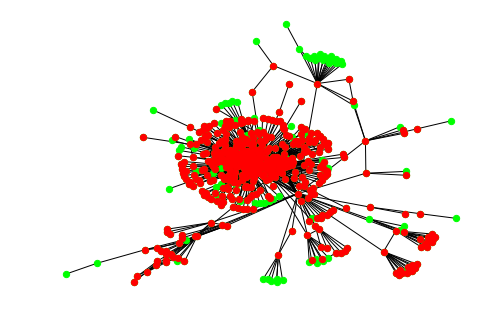

Day 15
Infected nodes: 471


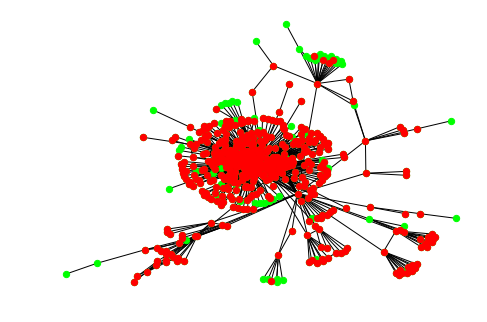

Day 16
Infected nodes: 488


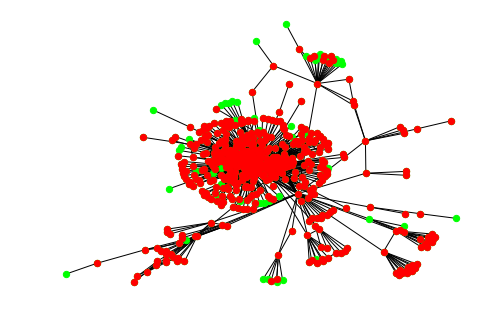

Day 17
Infected nodes: 496


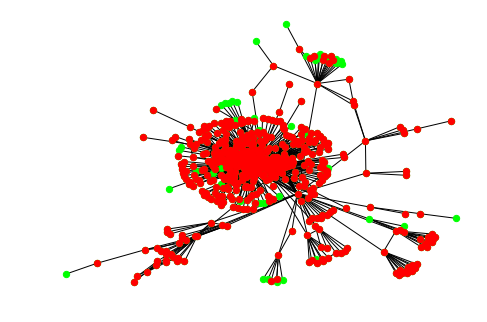

Day 18
Infected nodes: 505


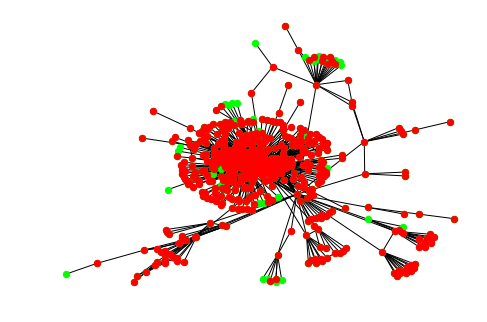

Day 19
Infected nodes: 515


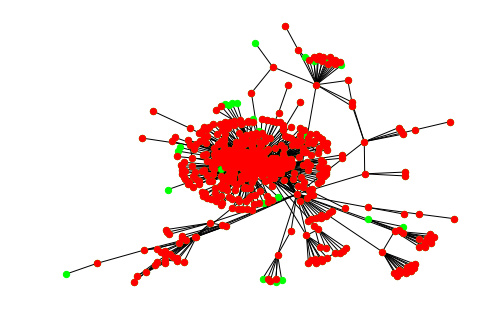

Day 20
Infected nodes: 522


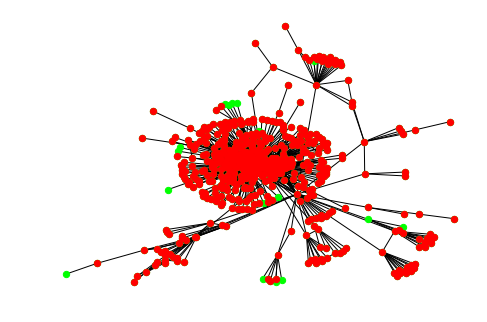

In [73]:
pos = nx.spring_layout(G0)
infected, susceptible = [], [n for n in G0.nodes()]
total_infected_1, total_susceptible_1 = [] , []
beta1 = 0.25
start_node = random.choice(susceptible)
infected.append(start_node)
susceptible.remove(start_node)

total_infected_1.append(len(infected))
total_susceptible_1.append(len(susceptible))


#fig, axes = plt.subplots(2,2,figsize = (12,10))
day = 1
print('Day {}'.format(day))
print('Infected nodes: {}'.format(len(infected)))
nx.draw(G0, pos = pos, node_color = 'lime', node_size = 40)
nx.draw_networkx_nodes(G0.subgraph(infected),pos=pos,node_color='red', node_size = 40)
plt.show()

num_days = 20
for day in range(1,num_days):
    day += 1
    
    frontier = nx.node_boundary(G0,infected)
    #frontier = frontier + [n for n in G.neighbors(node) if n not in infected]
    for node in frontier:
        p = random.random()
        if p < beta1:
            infected.append(node)
            susceptible.remove(node)
    
    total_infected_1.append(len(infected))
    total_susceptible_1.append(len(susceptible))
    
    print('Day {}'.format(day))
    print('Infected nodes: {}'.format(len(infected)))
    nx.draw(G0,pos=pos, node_color = 'lime', node_size = 40)
    nx.draw_networkx_nodes(G0.subgraph(infected),pos=pos,node_color='red', node_size = 40)
    plt.show()



Day 1
Infected nodes: 1


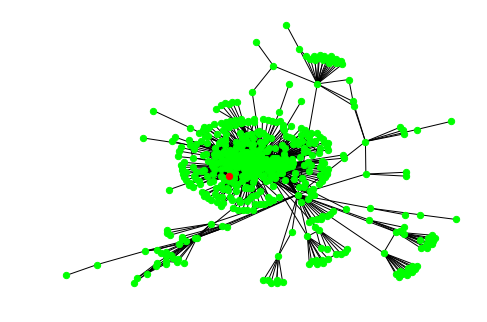

Day 2
Infected nodes: 3


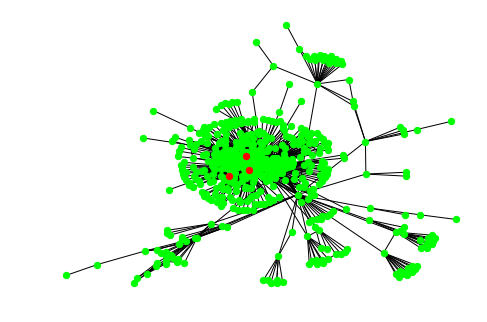

Day 3
Infected nodes: 98


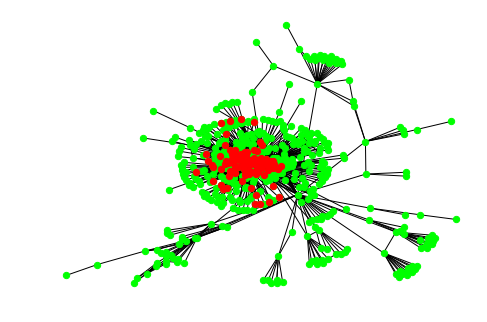

Day 4
Infected nodes: 193


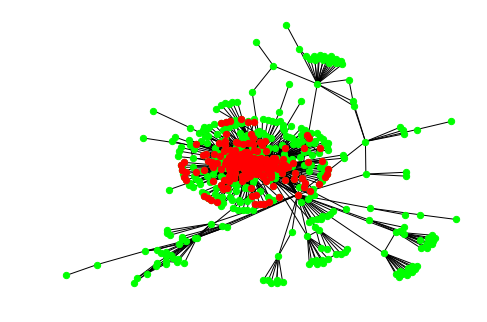

Day 5
Infected nodes: 287


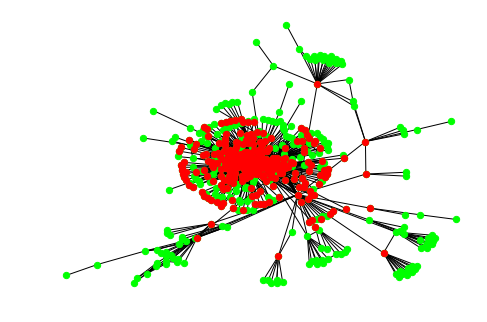

Day 6
Infected nodes: 379


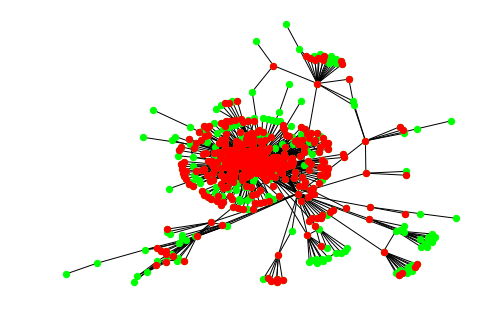

Day 7
Infected nodes: 437


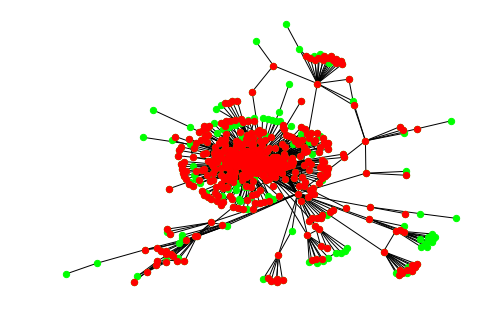

Day 8
Infected nodes: 489


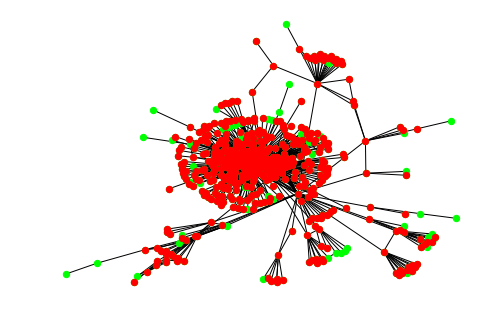

Day 9
Infected nodes: 513


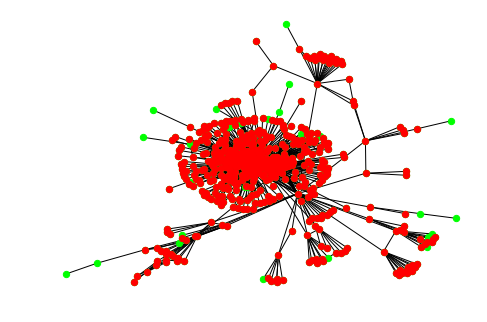

Day 10
Infected nodes: 527


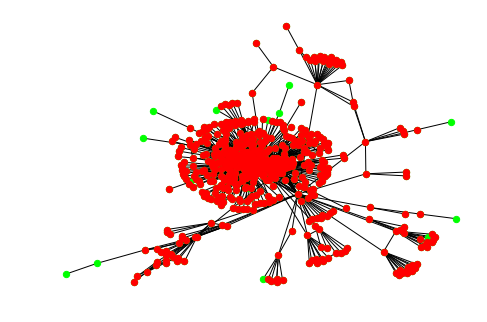

Day 11
Infected nodes: 531


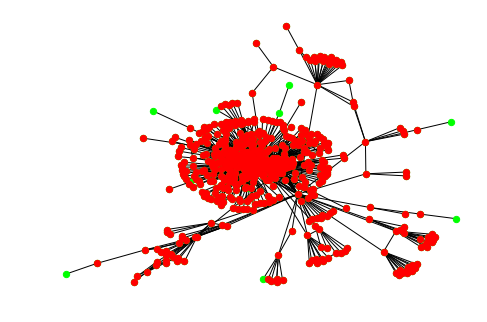

Day 12
Infected nodes: 533


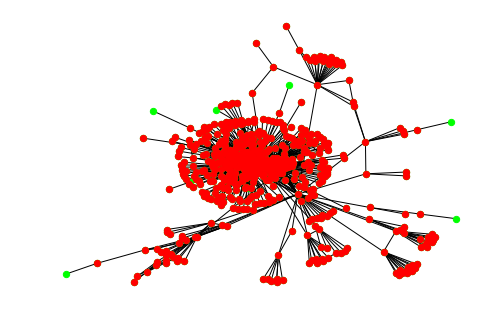

Day 13
Infected nodes: 537


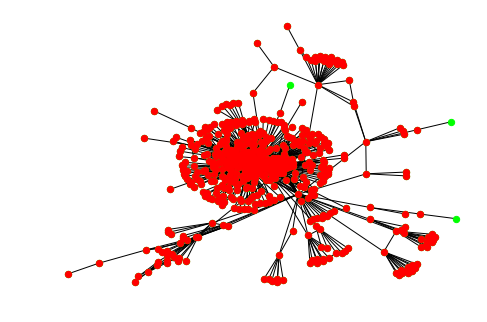

Day 14
Infected nodes: 538


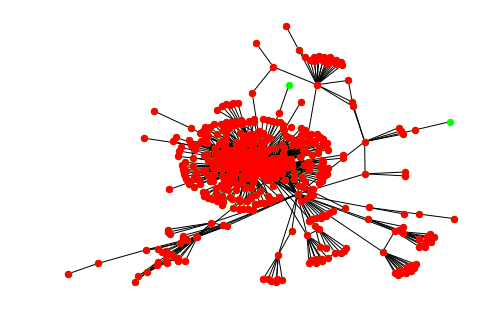

Day 15
Infected nodes: 540


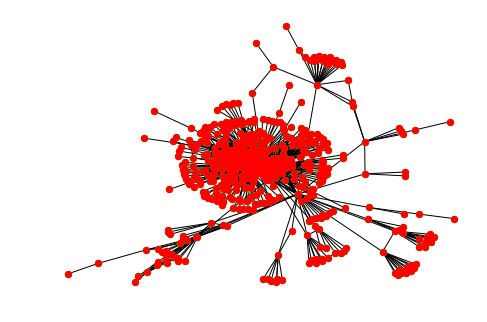

Day 16
Infected nodes: 541


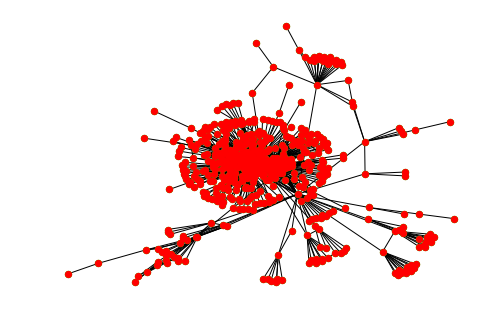

Day 17
Infected nodes: 541


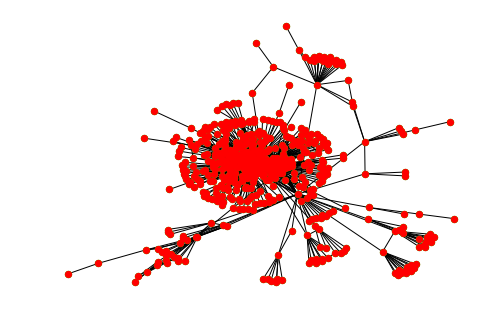

Day 18
Infected nodes: 541


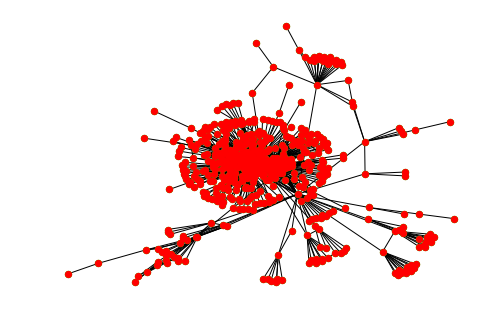

Day 19
Infected nodes: 541


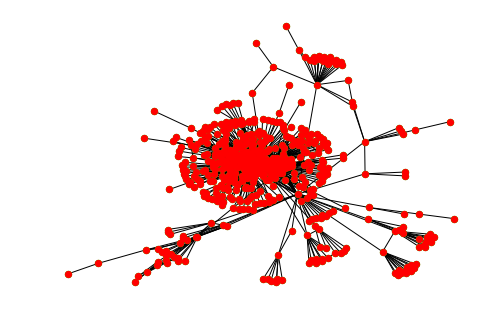

Day 20
Infected nodes: 541


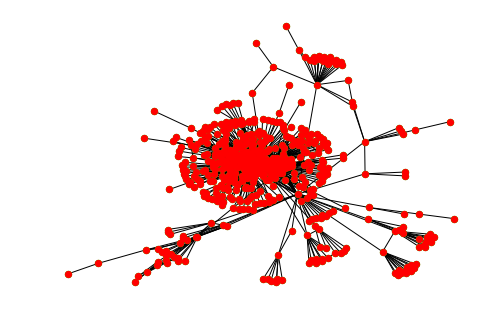

In [74]:
infected, susceptible = [], [n for n in G0.nodes()]
total_infected_2, total_susceptible_2 = [] , []
beta2 = 0.5
start_node = random.choice(susceptible)
infected.append(start_node)
susceptible.remove(start_node)

total_infected_2.append(len(infected))
total_susceptible_2.append(len(susceptible))


#fig, axes = plt.subplots(2,2,figsize = (12,10))
day = 1
print('Day {}'.format(day))
print('Infected nodes: {}'.format(len(infected)))
nx.draw(G0, pos = pos, node_color = 'lime', node_size = 40)
nx.draw_networkx_nodes(G0.subgraph(infected),pos=pos,node_color='red', node_size = 40)
plt.show()

num_days = 20
for day in range(1,num_days):
    day += 1
    
    frontier = nx.node_boundary(G0,infected)
    #frontier = frontier + [n for n in G.neighbors(node) if n not in infected]
    for node in frontier:
        p = random.random()
        if p < beta2:
            infected.append(node)
            susceptible.remove(node)
    
    total_infected_2.append(len(infected))
    total_susceptible_2.append(len(susceptible))
    
    print('Day {}'.format(day))
    print('Infected nodes: {}'.format(len(infected)))
    nx.draw(G0,pos=pos, node_color = 'lime', node_size = 40)
    nx.draw_networkx_nodes(G0.subgraph(infected),pos=pos,node_color='red', node_size = 40)
    plt.show()

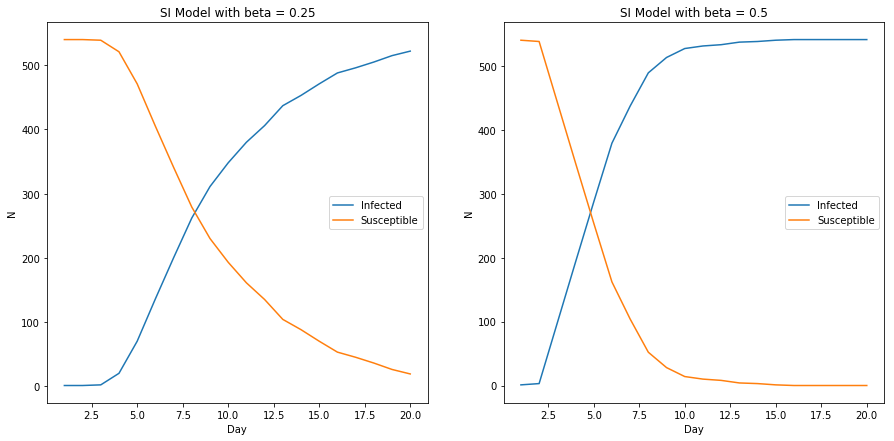

In [75]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize = (15,7))

ax1.plot(range(1,num_days+1), total_infected_1, label = 'Infected')
ax1.plot(range(1,num_days+1), total_susceptible_1, label = 'Susceptible')

ax1.set(xlabel = 'Day')
ax1.set(ylabel = 'N')
ax1.set(title='SI Model with beta = {}'.format(str(beta1)))
ax1.legend()

ax2.plot(range(1,num_days+1), total_infected_2, label = 'Infected')
ax2.plot(range(1,num_days+1), total_susceptible_2, label = 'Susceptible')

ax2.set(xlabel = 'Day')
ax2.set(ylabel = 'N')
ax2.set(title='SI Model with beta = {}'.format(str(beta2)))
ax2.legend()
plt.show()

Looking at these plots, it is quite clear that as the beta parameter of the SI model increases, the faster the propagation rate of vthe virus, where airports get infected at a higher rate. 

### Conclusions

In this part, we have compared the US air traffic network with a random network of similar characteristics and identified its similarites and differences. Some standard parameter values like the maximum degree was quite different, scale-free network degree distribution was badly approximated by the random network, as well as the clustering coefficient index, but the average path length estimate was good and similar to the real path distance. 

Then, different network communities generated with the Lovain and Girvan Newman methods were identified and analyzed, where each of these partitions could be easily identified by the geographical location shared among airports, and some communities were formed by important airports such as the Atlanta International Airport or Chicago O'Hare International Airport. 

Finally, robustness tests were simulated over the air traffic network, including efficiency checks when particular airports could not operate, and simulated cascade attacks for targeted and random initial failure. With these tests, scale free networks are known for being vulnerable to deliberate attacks, and a failure or crash in a central airport's system could completely interrupt the overall traffic in the network. At last, two different SI models were carried to simulate a hacking event or virus to an airport's informatic system, where the beta parameter characterizes the infection rate.